In [1]:
# library(ggplot2)
library(gridExtra)
library(matrixStats)
library(dplyr)
library(reshape2)
library(clusterCrit)
library(grid)
library(ggrepel)
library(RColorBrewer)
library(dplyr)
library(IRdisplay)
library(scales)
library(survival)
library(corrplot)
library(Hmisc)
source('../../../src/tools.R')     # custom tools function
source('../../../src/hdp_tools_yanis.R')
source("../../../src/merge_df.R")
source("../../../src/my_toolbox.R")
source("../../../src/my_components.R")
source("../../../src/my_utils.R")
source("../../../src/ggstyles.R")
source("../../../src/my_hotspots.R")
###


theme_set(theme_minimal())

# set jupyer notebook parameters
options(repr.plot.res        = 100, # set a medium-definition resolution for the jupyter notebooks plots (DPI)
        repr.matrix.max.rows = 200, # set the maximum number of rows displayed
        repr.matrix.max.cols = 200) # set the maximum number of columns displayed


Attaching package: ‘dplyr’

The following object is masked from ‘package:matrixStats’:

    count

The following object is masked from ‘package:gridExtra’:

    combine

The following objects are masked from ‘package:stats’:

    filter, lag

The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union

Loading required package: ggplot2

Attaching package: ‘survival’

The following object is masked from ‘package:clusterCrit’:

    concordance

corrplot 0.84 loaded
Loading required package: lattice
Loading required package: Formula

Attaching package: ‘Hmisc’

The following objects are masked from ‘package:dplyr’:

    src, summarize

The following objects are masked from ‘package:base’:

    format.pval, units

Run citation('hdp') for citation instructions,
    and file.show(system.file('LICENSE', package='hdp')) for license details.

Attaching package: ‘DescTools’

The following objects are masked from ‘package:Hmisc’:

    %nin%, Label, Mean, Quanti

In [2]:
correlates <- c("gender","age","ahd","perf_status","bm_blasts","secondary","wbc","hb","plt","os","cr","os_status")
binary_correlates <- c("gender","ahd","perf_status","secondary","os_status","cr")
continuous_correlates <- c("age","wbc","hb","plt","bm_blasts")
val=c("grey45", "#e79f00", "#009E73","#0072B2",  "#CC79A7",
                                      "#9ad0f3", "#D55E00","lightskyblue","mistyrose4", 
                                      "darkseagreen","lightgoldenrod","lightsalmon","#F0E442",
                                      "firebrick3","#000000","#870C14","#a6bddb","#fdbb84","deeppink")

In [3]:
plottings_comparison <-function(df1,df2=NULL,df3=NULL,df4=NULL,df5=NULL,df6=NULL,x1="", x2="",x3="",x4="",x5="",x6="",many=2,width=8,height=2){
        
    cat (paste(paste("Count",x1,sep=" : "),toString(dim(df1)[1]),sep=" : "),"\n")
    cat (paste(paste("Count",x2,sep=" : "),toString(dim(df2)[1]),sep=" : "),"\n")    
    if(many>=3){cat(paste(paste("Count",x3,sep=" : "),toString(dim(df3)[1]),sep=" : "),"\n")}
    if(many>=4){cat(paste(paste("Count",x4,sep=" : "),toString(dim(df4)[1]),sep=" : "),"\n")}
    if(many>=5){cat(paste(paste("Count",x5,sep=" : "),toString(dim(df5)[1]),sep=" : "),"\n")}
    if(many>=6){cat(paste(paste("Count",x6,sep=" : "),toString(dim(df6)[1]),sep=" : "),"\n")}
    
    vals=c("0" = "grey45", "1" = "#e79f00", "2" = "#009E73", "3" ="#0072B2", "4"="#CC79A7")
    set_notebook_plot_size(width,height)
    theme_1 = theme(axis.text.x = element_blank(),axis.ticks.x = element_blank())
    
    for (col in binary_correlates){ 
        p1 <-ggplot(df1, aes(factor(comparison), fill = factor(df1[,col]))) + 
            geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x1,fill=col)+
            scale_fill_manual(values = vals) + theme_1
        if (many==1){
            plot(p1)
        }else if (many==2){
            p2 <-ggplot(df2, aes(factor(comparison), fill = factor(df2[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x2,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            grid.arrange(p1,p2,nrow=1)
        }else if (many==3){
            p2 <-ggplot(df2, aes(factor(comparison), fill = factor(df2[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x2,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            p3 <-ggplot(df3, aes(factor(comparison), fill = factor(df3[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x3,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            grid.arrange(p1,p2,p3,nrow=1)
        }else if (many==4){
            p2 <-ggplot(df2, aes(factor(comparison), fill = factor(df2[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+xlab(x2)+labs(x=x2,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            p3 <-ggplot(df3, aes(factor(comparison), fill = factor(df3[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x3,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            p4 <-ggplot(df4, aes(factor(comparison), fill = factor(df4[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x4,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            grid.arrange(p1,p2,p3,p4,nrow=1)
        }
    }
    for (col in continuous_correlates){
        mini=suppressWarnings(min(min(df1[,col],na.rm=T),min(df2[,col],na.rm=T),min(df3[,col],na.rm=T),min(df4[,col],na.rm=T),na.rm=T))
        maxi=suppressWarnings(max(max(df1[,col],na.rm=T),max(df2[,col],na.rm=T),max(df3[,col],na.rm=T),max(df4[,col],na.rm=T),na.rm=T))
 
        p1 <- ggplot(df1,aes(x=factor(comparison),y=df1[,col],fill=comparison)) +
                geom_boxplot(aes(fill = factor(comparison))) +  ylab(col)+xlab(x1)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
        if (many==1){
            suppressWarnings(plot(p1))
        }else if(many==2){
            p2 <- ggplot(df2,aes(x=factor(comparison),y=df2[,col],fill=comparison)) +
                    geom_boxplot(aes(fill = factor(comparison))) +  ylab(col)+xlab(x2)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            suppressWarnings(grid.arrange(p1,p2,nrow=1))
        }else if(many==3){
            p2 <- ggplot(df2,aes(x=factor(comparison),y=df2[,col],fill=comparison)) +
                    geom_boxplot(aes(fill = factor(comparison))) +  ylab(col)+xlab(x2)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            p3 <- ggplot(df3,aes(x=factor(comparison),y=df3[,col],fill=comparison)) +
                    geom_boxplot(aes(fill = factor(comparison))) +  ylab(col)+xlab(x3)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            suppressWarnings(grid.arrange(p1,p2,p3,nrow=1))
        }else if(many==4){
            p2 <- ggplot(df2,aes(x=factor(comparison),y=df2[,col],fill=comparison)) +
                    geom_boxplot(aes(fill = factor(comparison))) +  ylab(col)+xlab(x2)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            p3 <- ggplot(df3,aes(x=factor(comparison),y=df3[,col],fill=comparison)) +
                    geom_boxplot(aes(fill = factor(comparison))) +  ylab(col)+xlab(x3)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            p4 <- ggplot(df4,aes(x=factor(comparison),y=df4[,col],fill=comparison)) +
                    geom_boxplot(aes(fill = factor(comparison))) +  ylab(col)+xlab(x4)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            suppressWarnings(grid.arrange(p1,p2,p3,p4,nrow=1))
        }
    }
}

In [4]:
plottings <-function(df1,df2=NULL,df3=NULL,df4=NULL,df5=NULL,df6=NULL,x1="with NPM1", x2="without NPM1",x3="",x4="",x5="",x6="",many=2,width=8,height=2){
    cat (paste(paste("Count",x1,sep=" : "),toString(dim(df1)[1]),sep=" : "),"\n")
    cat (paste(paste("Count",x2,sep=" : "),toString(dim(df2)[1]),sep=" : "),"\n")    
    if(many>=3){cat(paste(paste("Count",x3,sep=" : "),toString(dim(df3)[1]),sep=" : "),"\n")}
    if(many>=4){cat(paste(paste("Count",x4,sep=" : "),toString(dim(df4)[1]),sep=" : "),"\n")}
    if(many>=5){cat(paste(paste("Count",x5,sep=" : "),toString(dim(df5)[1]),sep=" : "),"\n")}
    if(many>=6){cat(paste(paste("Count",x6,sep=" : "),toString(dim(df6)[1]),sep=" : "),"\n")}
    
    vals=c("0" = "grey45", "1" = "#e79f00", "2" = "#009E73", "3" ="#0072B2", "4"="#CC79A7")
    set_notebook_plot_size(width,height)
    theme_1 = theme(axis.text.x = element_blank(),axis.ticks.x = element_blank())
    
    for (col in binary_correlates){ 
        p1 <-ggplot(df1, aes(factor(final_component), fill = factor(df1[,col]))) + 
            geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x1,fill=col)+
            scale_fill_manual(values = vals) + theme_1  # set ymin to 0 (Elli's request)
        
        if (many==1){
            plot(p1)
        }else if (many==2){
            p2 <-ggplot(df2, aes(factor(final_component), fill = factor(df2[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x2,fill=col)+
                scale_fill_manual(values = vals) + theme_1 
            grid.arrange(p1,p2,nrow=1)
        }else if (many==3){
            p2 <-ggplot(df2, aes(factor(final_component), fill = factor(df2[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x2,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            p3 <-ggplot(df3, aes(factor(final_component), fill = factor(df3[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x3,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            grid.arrange(p1,p2,p3,nrow=1)
        }else if (many==4){
            p2 <-ggplot(df2, aes(factor(final_component), fill = factor(df2[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+xlab(x2)+labs(x=x2,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            p3 <-ggplot(df3, aes(factor(final_component), fill = factor(df3[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x3,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            p4 <-ggplot(df4, aes(factor(final_component), fill = factor(df4[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x4,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            grid.arrange(p1,p2,p3,p4,nrow=1)
        }else if (many==5){
            p2 <-ggplot(df2, aes(factor(final_component), fill = factor(df2[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+xlab(x2)+labs(x=x2,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            p3 <-ggplot(df3, aes(factor(final_component), fill = factor(df3[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x3,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            p4 <-ggplot(df4, aes(factor(final_component), fill = factor(df4[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x4,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            p5 <-ggplot(df5, aes(factor(final_component), fill = factor(df5[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x5,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            grid.arrange(p1,p2,p3,p4,p5,nrow=1)
        }
    }
    for (col in continuous_correlates){
        mini=suppressWarnings(min(min(df1[,col],na.rm=T),min(df2[,col],na.rm=T),min(df3[,col],na.rm=T),min(df4[,col],na.rm=T),na.rm=T))
        maxi=suppressWarnings(max(max(df1[,col],na.rm=T),max(df2[,col],na.rm=T),max(df3[,col],na.rm=T),max(df4[,col],na.rm=T),na.rm=T))
 
        p1 <- ggplot(df1,aes(x=factor(final_component),y=df1[,col],fill=final_component)) +
                geom_boxplot(aes(fill = factor(final_component))) +  ylab(col)+xlab(x1)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
        if (many==1){
            suppressWarnings(plot(p1))
        }else if(many==2){
            p2 <- ggplot(df2,aes(x=factor(final_component),y=df2[,col],fill=final_component)) +
                    geom_boxplot(aes(fill = factor(final_component))) +  ylab(col)+xlab(x2)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            suppressWarnings(grid.arrange(p1,p2,nrow=1))
        }else if(many==3){
            p2 <- ggplot(df2,aes(x=factor(final_component),y=df2[,col],fill=final_component)) +
                    geom_boxplot(aes(fill = factor(final_component))) +  ylab(col)+xlab(x2)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            p3 <- ggplot(df3,aes(x=factor(final_component),y=df3[,col],fill=final_component)) +
                    geom_boxplot(aes(fill = factor(final_component))) +  ylab(col)+xlab(x3)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            suppressWarnings(grid.arrange(p1,p2,p3,nrow=1))
        }else if(many==4){
            p2 <- ggplot(df2,aes(x=factor(final_component),y=df2[,col],fill=final_component)) +
                    geom_boxplot(aes(fill = factor(final_component))) +  ylab(col)+xlab(x2)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            p3 <- ggplot(df3,aes(x=factor(final_component),y=df3[,col],fill=final_component)) +
                    geom_boxplot(aes(fill = factor(final_component))) +  ylab(col)+xlab(x3)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            p4 <- ggplot(df4,aes(x=factor(final_component),y=df4[,col],fill=final_component)) +
                    geom_boxplot(aes(fill = factor(final_component))) +  ylab(col)+xlab(x4)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            suppressWarnings(grid.arrange(p1,p2,p3,p4,nrow=1))
        }else if(many==5){
            p2 <- ggplot(df2,aes(x=factor(final_component),y=df2[,col],fill=final_component)) +
                    geom_boxplot(aes(fill = factor(final_component))) +  ylab(col)+xlab(x2)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            p3 <- ggplot(df3,aes(x=factor(final_component),y=df3[,col],fill=final_component)) +
                    geom_boxplot(aes(fill = factor(final_component))) +  ylab(col)+xlab(x3)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            p4 <- ggplot(df4,aes(x=factor(final_component),y=df4[,col],fill=final_component)) +
                    geom_boxplot(aes(fill = factor(final_component))) +  ylab(col)+xlab(x4)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00"))
            p5 <- ggplot(df5,aes(x=factor(final_component),y=df5[,col],fill=final_component)) +
                    geom_boxplot(aes(fill = factor(final_component))) +  ylab(col)+xlab(x5)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            suppressWarnings(grid.arrange(p1,p2,p3,p4,p5,nrow=1))
        }
    }
}

In [5]:
plot_surv <-function(df_surv,title="",width=15,height=6,vals=val){
    set_notebook_plot_size(width,height)
    surv_object <- Surv(time = df_surv$os, event = df_surv$os_status)
    fit1 <- survfit(surv_object ~ comparison, data = df_surv)
    ggsurvplot(fit1, data = df_surv, pval = TRUE,risk.table = TRUE,ggtheme = theme_minimal(),
    risk.table.y.text.col = T,
    risk.table.y.text = T,break.time.by = 1,title= title,palette=as.vector(vals[1:length(unique(df_surv$comparison))]))
}

In [6]:
### Dataframe preparation
df_all_components <- read.table("df_final_with_components.tsv")
df_initial <- read.table("../../../data/initial_dataset/Master_04_10_2019.csv",sep = ',' , header = T) 
rownames(df_initial) <- df_initial$data_pd
df_initial <- df_initial[,-1:-4]

In [7]:
### Table prepapration with count of each contributors for each component
cols_to_keep = c(1:153,155)
tmp_cat <- as.data.frame(sapply(df_all_components[,cols_to_keep], as.numeric))
categories_repartition <- data.frame(category = colnames(tmp_cat[1:(length(tmp_cat)-1)]))
for (i in 1:length(levels(factor(df_all_components$final_component))))
    categories_repartition[levels(factor(df_all_components$final_component))[i]] <- apply(categories_repartition, 1, function(s) sum(tmp_cat[tmp_cat$final_component_numeric == i, s['category']]))
categories_repartition['total_count'] <- rowSums(categories_repartition[,-1])

In [8]:
# Useful function for main contributors
main_contributors_analysis <- function(component_name,threshold=0.2,many=3,width=6.5,height=2,plot="yes"){
    cat(paste("Numer of patients in this component : ",dim(df_all_components[df_all_components$final_component==component_name,])[1]),"\n")
    cat(paste("Table with the most frequent features for this component in decreasing order :"),"\n")
    tmp <-categories_repartition[categories_repartition[,component_name]>=threshold*dim(df_all_components[df_all_components$final_component==component_name,])[1],c("category",component_name)]
    print(tmp[order(tmp[,component_name],decreasing=T),])
    cat("\n\n")
    df_nc_1 <- merge(df_w_correlates,df_all_components[,levels(factor(tmp$category))],by=0)
    rownames(df_nc_1) <- df_nc_1$Row.names
    df_nc_1 <- df_nc_1 [,-1]
    df_nc_1$sum_contributors <- rowSums(df_nc_1[,levels(factor(tmp$category))])

    ### Compare clinical correlates based on how many contributors are present:
    df_nc_1$comparison <- ifelse(df_nc_1$final_component==component_name & df_nc_1$sum_contributors >=2 ,"with_2++contributors",
                          ifelse(df_nc_1$final_component==component_name & df_nc_1$sum_contributors ==1 ,"with_1contributor",
                          ifelse(df_nc_1$final_component==component_name & df_nc_1$sum_contributors ==0 ,"with_0contributor","other components")))
    if (plot=="yes"){
        plottings_comparison(df_nc_1[df_nc_1$comparison=="with_2++contributors",],
                         df_nc_1[df_nc_1$comparison=="with_1contributor",],
                         df_nc_1[df_nc_1$comparison=="with_0contributor",],x1="2++contributors",x2="1 contributor",x3="0contributor",many=many,width=width,height=height)  
        }
    return (df_nc_1)
}

# Summary of the notebook:
## __I) Some general plots__
### [ I.1) Heatmap for the refined components](#heatmap)
### [ I.2) Correlation(plot)](#corr)
### [ I.3) Clinical correlates for categorical variables](#clincorr)
### [ I.4) Clinical correlates for continuous variables](#clincont)
### [ I.5) Survival Plots](#surv)
### [ I.6) Clinical categorical correlates for each component VS others](#catcorr)
### [ I.7) Clinical continuous correlates for each component VS others](#contcorr)
### [ I.8) Survival Plot for each component VS Others](#survcomp)
### [ I.9) Genetical and cytogenical frequency within components](#gencytfreq)



### For part II and III , check the rest of the analysis in Analysis_final_component notebook
## __II) Specific requests : Evaluate contributors for the complex components__ 
### [II.1) New Component1 Contributors](#nc1c)
### [II.2) New Component2 Contributors](#nc2c)
### [II.3) New Component3 Contributors](#nc3c)
### [II.4) New Component Splicing Contributors](#splicing)
### [II.5) New Component4 Contributors](#nc4c)
### [II.6) New Component6 Contributors](#nc6c)
### [II.7) New Component7 Contributors](#nc7c)
### [II.8) Not assigned patients Contributors](#ncnotc)

## __III) Takeaway of analysis and verification that conclusion of previous analysis still hold__ 
### [III.1)Takeaway of the analysis with articles](#take)
### [III.2) Analysis by Final Component](#ana)

# __I) Some general Plots__

# I.1) Heatmap for the refined components

Order of Components : 
NPM1  , TP53_complex  , t_11  , t_15_17  , t_8_21  , CEBPA_bi  , inv_3  , BAGE3_KMT2C  , chr_splicing_multiple  , chr_splicing_1  , DNMT3A_IDH1_2  , WT1_t_6_9_ITD  , KIT_NRAS  , additions  , not_assigned  ,

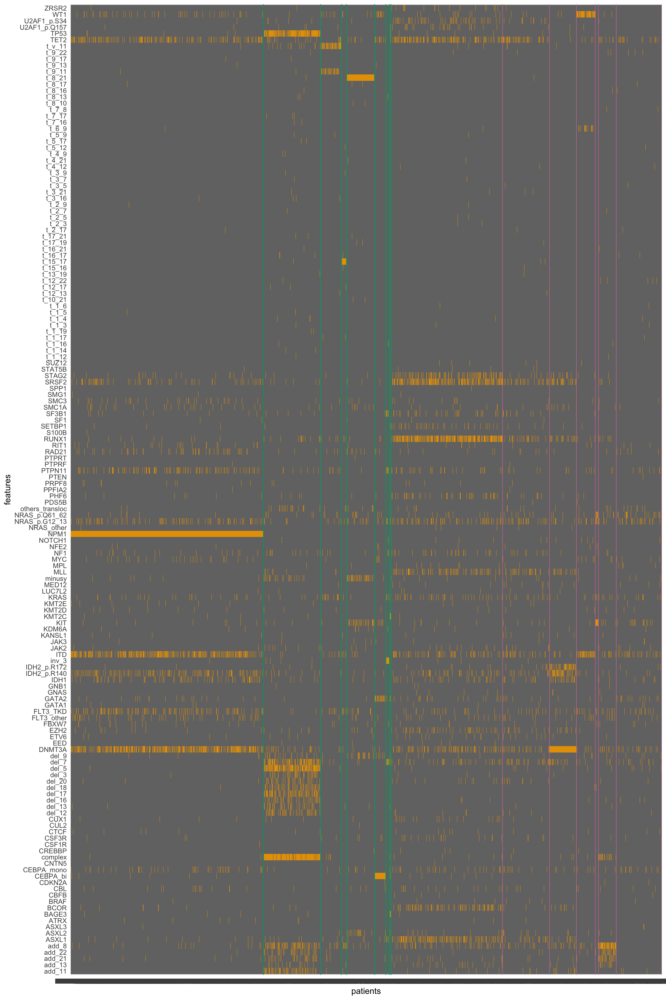

In [9]:
cols_to_keep = c(1:153,155)
tmp_all <- df_all_components[,cols_to_keep][order(df_all_components[,cols_to_keep]$final_component_numeric),]
transp_df_all <-(as.data.frame(t(tmp_all)))
transp_df_all$features <- rownames(transp_df_all)
transp_df_all <- transp_df_all[! row.names(transp_df_all) == "final_component_numeric",]
melt.data_all<-melt(transp_df_all,id.vars ="features", variable_name=colnames(transp_df_all))
options(repr.plot.res = 200)
set_notebook_plot_size(12, 18)
col_sep <- tabulate(df_all_components[,cols_to_keep]$final_component_numeric)   ## to separate by component

cat("Order of Components :","\n")
cat(paste(unique(df_all_components[order(df_all_components[,cols_to_keep]$final_component_numeric),]$final_component)," ,"))
# plot the heatmap
ggplot(melt.data_all, aes(variable,features)) +
geom_raster(aes(fill = factor(value)), show.legend = FALSE) +
scale_fill_manual(values = c("0" = "grey45", "1" = "#e79f00")) +
geom_vline(xintercept = cumsum(col_sep)[1:8] + 0.5, col = "#009E73", linetype = 1, size = 0.5) +
geom_vline(xintercept = cumsum(col_sep)[9:15] + 0.5, col = "#CC79A7", linetype = 1, size = 0.3) +
labs(x = 'patients') 

In [10]:
df_w_correlates <- merge(df_initial[correlates],df_all_components['final_component'],by=0)
rownames(df_w_correlates) <- df_w_correlates$Row.names
df_w_correlates <- df_w_correlates [,-1]

# I.2-Correlation plot for clinical variables

<a id='corr'></a>

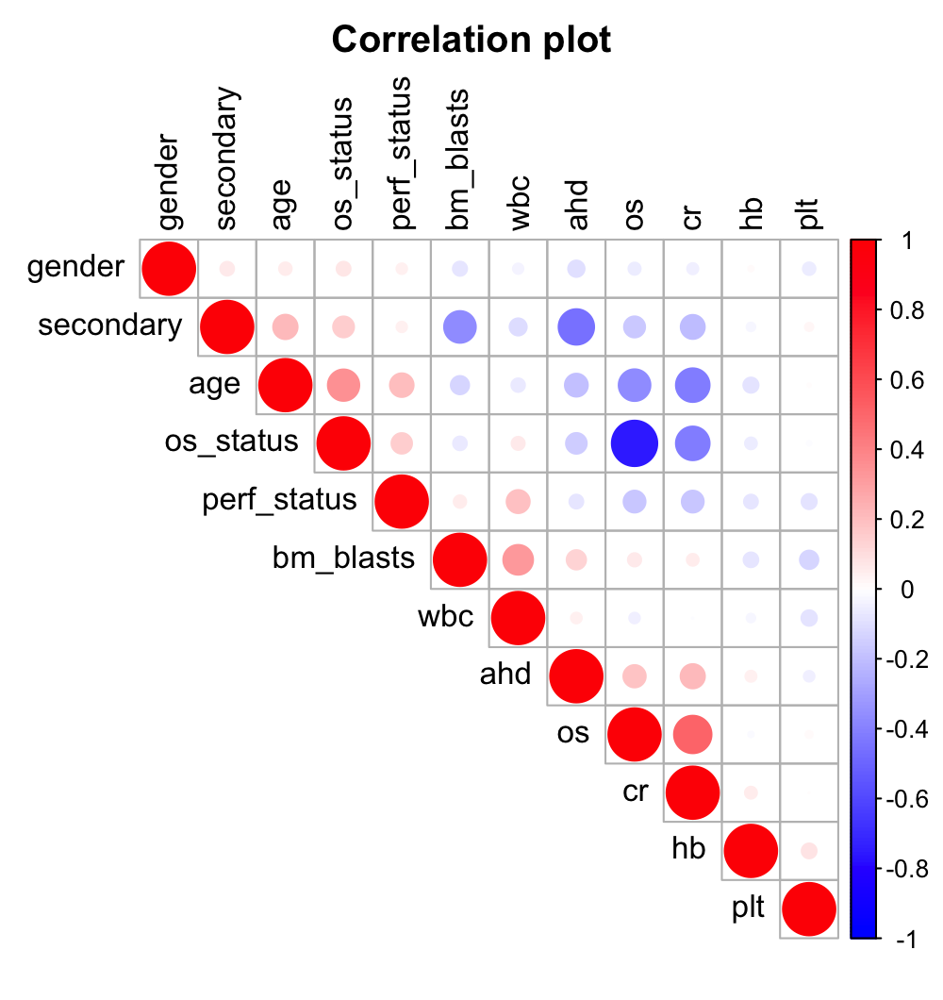

In [11]:
set_notebook_plot_size(5,5.3)
corrplot(rcorr(as.matrix(df_w_correlates[,!names(df_w_correlates) %in% "final_component"]))$r,type="upper", order = "hclust", 
         tl.col = "black",col=colorRampPalette(c("blue","white","red"))(200),mar=c(0,0,2,0),title="Correlation plot")


# I.3 - Clinical correlates for categorical variables

<a id='clincorr'></a>

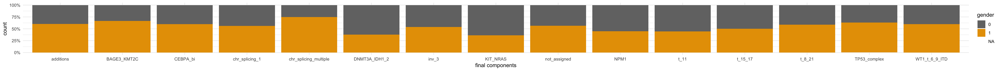

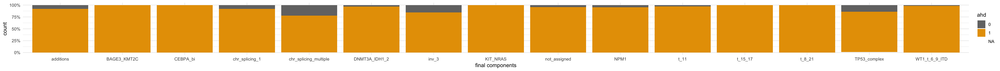

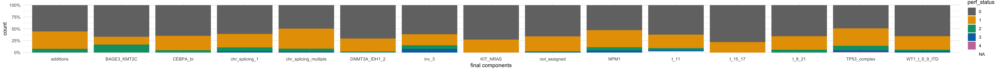

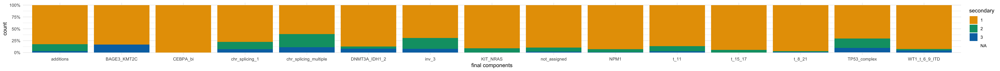

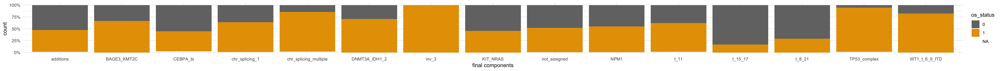

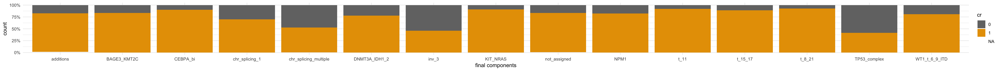

In [12]:
set_notebook_plot_size(28,2)
v=c("0" = "grey45", "1" = "#e79f00", "2" = "#009E73", "3" ="#0072B2", "4"="#CC79A7")
for (col in binary_correlates){
p <- ggplot(df_w_correlates, aes(factor(final_component), fill = factor(df_w_correlates[,col]))) +
  geom_bar(position = "fill") +
  scale_y_continuous(labels = scales::percent)+
  xlab("final components")+scale_fill_manual(values = v)+
  labs(fill=col)
    plot(p)
}


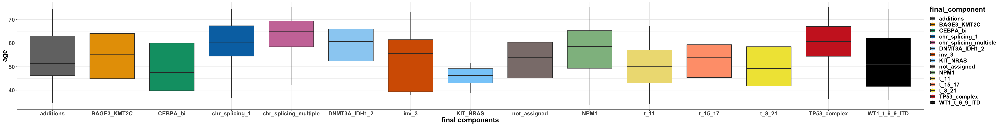

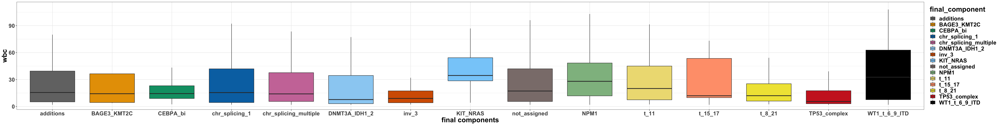

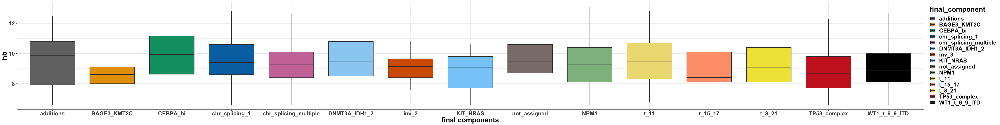

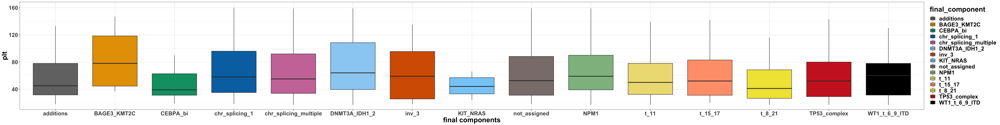

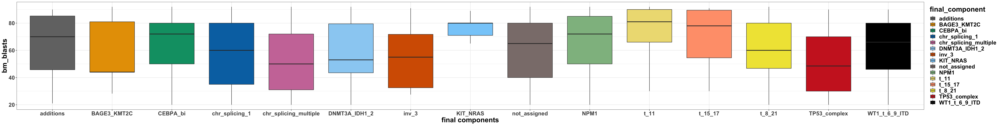

In [13]:
set_notebook_plot_size(40,5)
for (col in continuous_correlates){
    p <- ggplot(df_w_correlates,aes(x=factor(final_component),y=df_w_correlates[,col],fill=final_component)) +
    geom_boxplot(aes(fill = factor(final_component)),outlier.shape = NA) + 
    theme1+scale_fill_manual(values=c("grey45", "#e79f00", "#009E73","#0072B2",  "#CC79A7",
                                      "#9ad0f3", "#D55E00","lightskyblue","mistyrose4", 
                                      "darkseagreen","lightgoldenrod","lightsalmon","#F0E442",
                                      "firebrick3","#000000","#870C14","#a6bddb","#fdbb84","deeppink"))+
    ylab(col)+xlab("final components")+scale_y_continuous(limits = quantile(df_w_correlates[,col], c(0.1, 0.9),na.rm = T))
    #scale_y_continuous(limits = c(0, NA), expand = c(0,0)) +scale_y_log10()
    # set ymin to 0 (Elli's request)
    suppressWarnings(plot(p))
    
}

# I.5- Survival Plots

<a id='surv'></a>

In [14]:
surv_object <- Surv(time = df_w_correlates$os, event = df_w_correlates$os_status)

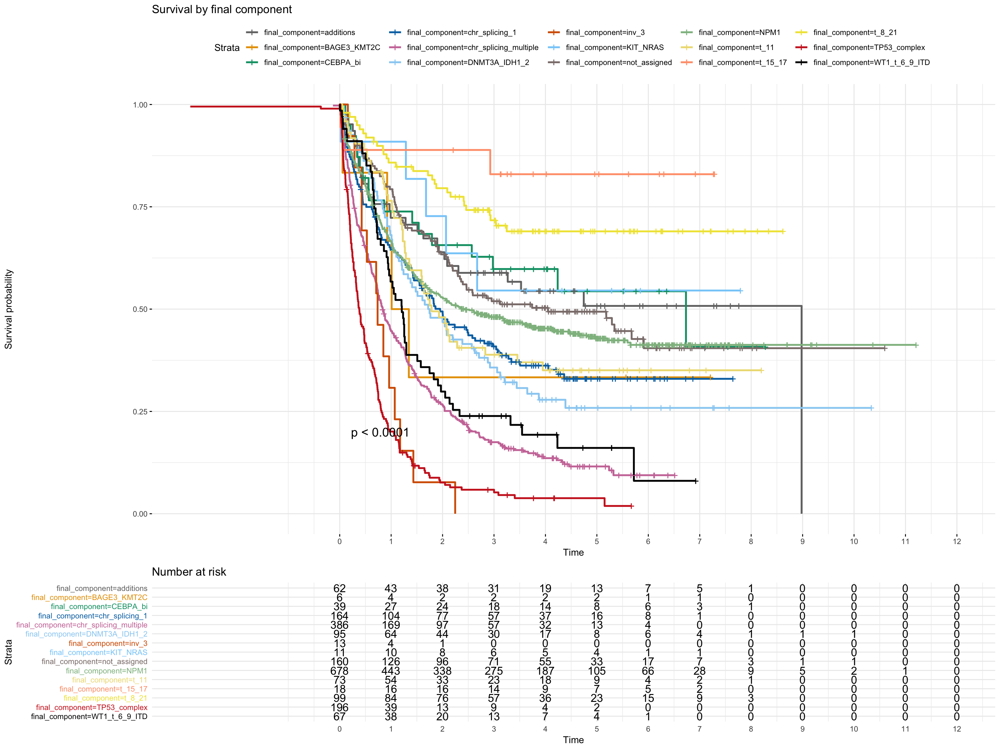

In [15]:
set_notebook_plot_size(16,12)
fit1 <- survfit(surv_object ~ final_component, data = df_w_correlates)

ggsurvplot(fit1, data = df_w_correlates, pval = TRUE,risk.table = TRUE,ggtheme = theme_minimal(),
 risk.table.y.text.col = T,
  risk.table.y.text = T,break.time.by = 1,title= "Survival by final component",palette=val)


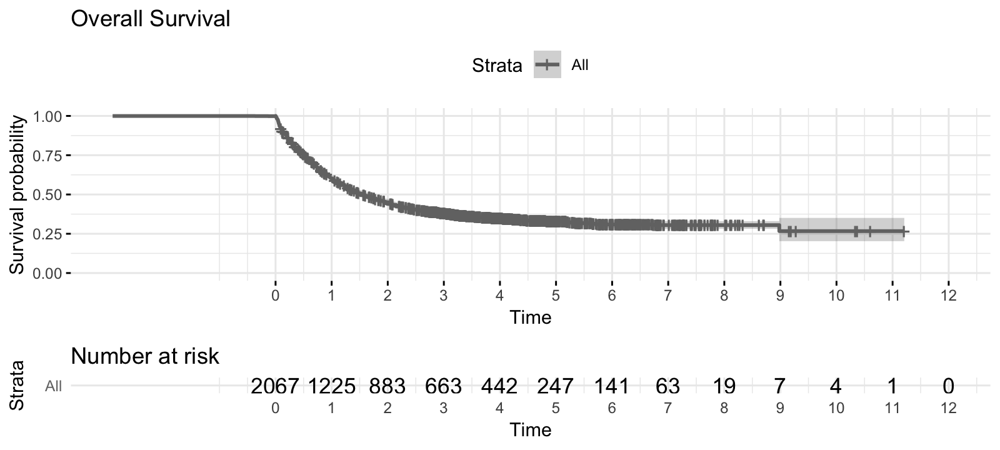

In [16]:
set_notebook_plot_size(8,3.6)
fit_all <- survfit(surv_object ~1, data = df_w_correlates)
ggsurvplot(fit_all, data = df_w_correlates, risk.table = TRUE,ggtheme = theme_minimal(),
 risk.table.y.text.col = T,
  risk.table.y.text = T,break.time.by = 1,title="Overall Survival",palette="grey45")

# I.6- Clinical categorical correlates for each component VS others

<a id='catcorr'></a>

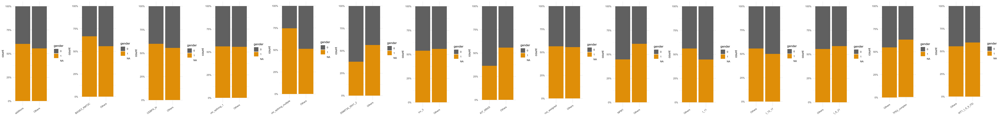

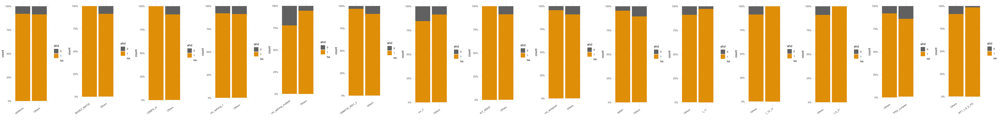

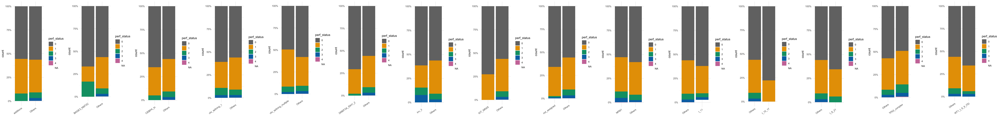

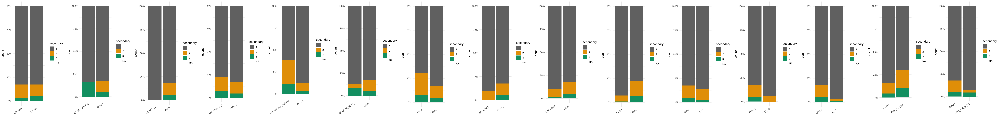

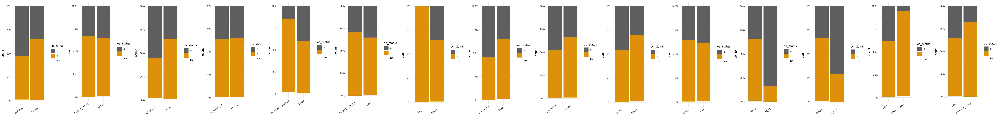

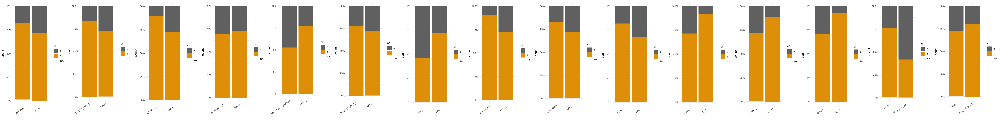

In [17]:
set_notebook_plot_size(50,6)
tmp <-df_w_correlates
list_component <- levels(factor(df_w_correlates$final_component))
categlist <- list()
for (col in binary_correlates){
    for (i in list_component){
    tmp$comparison <- ifelse((tmp$final_component==i),i,"Others") 
    categlist[[i]]<- ggplot(tmp, aes(x = factor(comparison), fill = factor(tmp[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+xlab("")+
                scale_fill_manual(values = val)+labs(fill=col) +theme(axis.text.x = element_text(angle = 35, hjust = 1))

    }
    grid.arrange(grobs=categlist,ncol=length(list_component))
}


# I.7- Clinical continuous correlates for each component VS others

<a id='contcorr'></a>

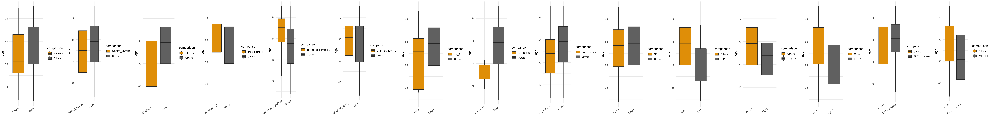

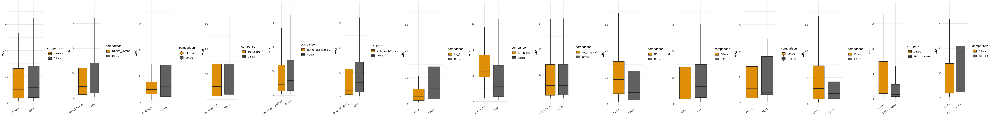

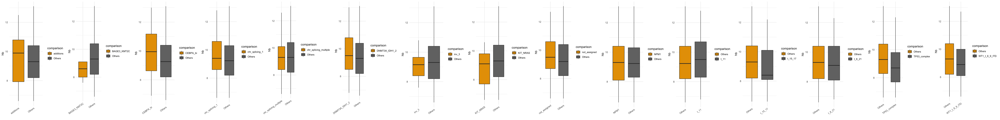

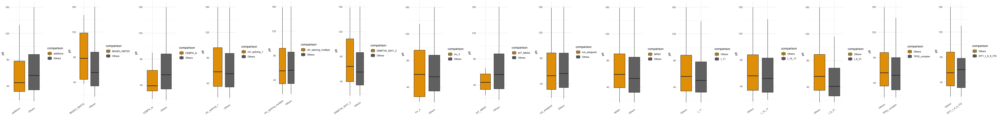

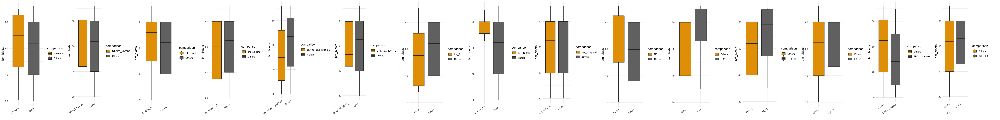

In [18]:
set_notebook_plot_size(50,6)
categlist <- list()
contlist <- list()
for (col in continuous_correlates){
    for (i in list_component){
    tmp$comparison <- ifelse((tmp$final_component==i),i,"Others") 
    contlist[[i]]<- ggplot(tmp,aes(x=factor(comparison),y=tmp[,col],fill=comparison)) +
                geom_boxplot(aes(fill = factor(comparison)),outlier.shape = NA) +  ylab(col)+scale_fill_manual(values=c("#e79f00","grey45"))+scale_y_continuous(limits = quantile(tmp[,col], c(0.1, 0.9),na.rm = T))+
        theme(axis.text.x = element_text(angle = 35, hjust = 1))+xlab("")

    }
    suppressWarnings(grid.arrange(grobs=contlist,ncol=length(list_component)))
}

# I.8- Survival Plot for each component VS Others

<a id='survcomp'></a>

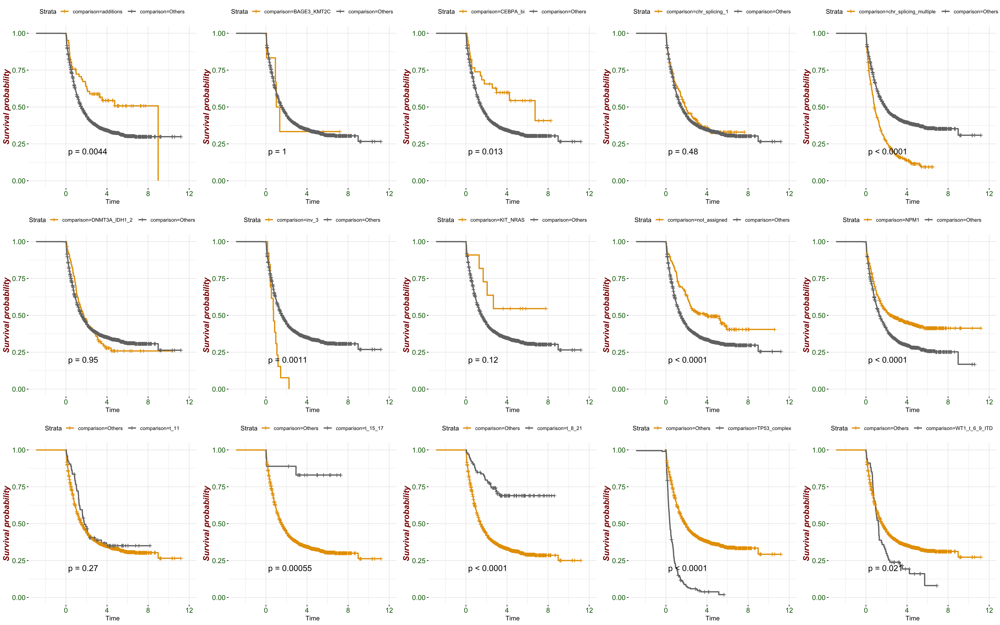

In [19]:
set_notebook_plot_size(24,15)
survlist <- list()
for (i in list_component){
tmp$comparison <- ifelse((tmp$final_component==i),i,"Others") 
surv_object <- Surv(time = tmp$os, event = tmp$os_status)
fit <- survfit(surv_object ~ comparison, data = tmp)
survlist[[i]]<-ggsurvplot(fit, data = tmp, pval = TRUE,ggtheme = theme_minimal(),main = "Survival curve",
   font.main = c(16, "bold", "darkblue"),
   font.y = c(14, "bold.italic", "darkred"),  
   palette = c("#e79f00","grey45"),
   font.tickslab = c(12, "plain", "darkgreen"))$plot
}
grid.arrange(grobs=survlist,ncol=5)

# I.9- Genetical and cytogenical frequency within components

<a id='gencytfreq'></a>

In [20]:
tmp_cat <- as.data.frame(sapply(df_all_components[,cols_to_keep], as.numeric))
categories_repartition1 <- data.frame(category = colnames(tmp_cat))
for (i in 1:length(levels(factor(df_all_components$final_component))))
    categories_repartition1[sprintf('component_%d', i)] <- apply(categories_repartition1, 1, function(s) (sum(tmp_cat[tmp_cat$final_component_numeric == i, s['category']])/nrow(tmp_cat[tmp_cat$final_component_numeric ==i,])))
categories_repartition1 <- categories_repartition1[! categories_repartition1$category == "final_component_numeric",]
set_notebook_plot_size(130,10)
i <-1
for (col in colnames(categories_repartition1)[-1]){
    plot(ggplot(categories_repartition1,aes(factor(category),y=categories_repartition1[,col]))+geom_bar(stat='identity')+xlab("")+scale_fill_manual(values="#e79f00")
     +ylab(paste("Frequency of features by ",levels(factor(df_all_components$final_component))[i]))+theme(axis.text.x = element_text(angle = 90, hjust = 1, size=13,color="darkred"))
     +theme(axis.title.y = element_text(family="serif", size = 40, angle = 90, vjust = 0.25))+ylim(0,1))
    i <-i+1
    }